# Reinforcement Learning Offline

### Phase 0: Import libraries and read data

In [1]:
# import libraries
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import plotly.express as px
import d3rlpy
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import seaborn as sns
sns.set_theme()

In [2]:
variables_interes=['pyrite law', 'chalcopyrite law',
       'chalcocite law', 'covelin law', 'crusher index', 'sag power index',
       'ball work index', 'bornite law','charge cell', 'TPH','water', 'speed','HH TPH', 'granulometry','loss of TPH',
       "power","solid percentage","HH charge cell","LL charge cell","delta HH TPH","delta HH charge cell","delta LL charge cell"]

In [3]:
states=[
 'charge cell',
 'water',
 'speed',
 'HH TPH',
 'granulometry',
 'solid percentage',
 'HH charge cell',
 ]

actions=[
    'HH charge cell'
    ]

reward=[
    "loss of TPH"
    ]

In [4]:
# read dictionary
tags=pd.read_excel("..\\data\\tags relevantes.xlsx")
tags_cc=tags.tag.to_list()
dic={}
for i,j in zip(tags.tag,tags.description):
    dic[i]=j

In [5]:
# read data
df=pd.read_csv("..\data\cleaned_15December2022.csv", parse_dates=['Timestamp'], index_col='Timestamp')
df.rename(columns=dic,inplace=True)
df["delta HH TPH"]=df["HH TPH"]-df["TPH"]
df["delta HH charge cell"]=df["HH charge cell"]-df["charge cell"]
df["delta LL charge cell"]=df["charge cell"]-df["LL charge cell"]
df["loss of TPH"]=df["delta HH TPH"].apply(lambda x: -1 if x>100 else 1)
df=df[variables_interes]

# Done MDP: se considera como tarea finalizada cuando el turno termina a las 12:00 o 00:00
df["terminals"]=df.reset_index().apply(lambda x: 1 if (x["Timestamp"].strftime("%H:%M")=="12:00") or (x["Timestamp"].strftime("%H:%M")=="00:00") else 0,axis=1).values

df.head(1)

,pyrite law,chalcopyrite law,chalcocite law,covelin law,crusher index,sag power index,ball work index,bornite law,charge cell,TPH,...,granulometry,loss of TPH,power,solid percentage,HH charge cell,LL charge cell,delta HH TPH,delta HH charge cell,delta LL charge cell,terminals
Timestamp,,,,,,,,,,,,,,,,,,,,,
2018-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,864.295848,3847.009774,...,NaN,-1,23071.203516,65.090716,900.0,820.0,502.990226,35.704152,44.295848,1


### Phase 1: Split data train/test & processing

In [6]:
# Entrenamiento
entrenamiento=pd.concat([df["2020-01":"2020-09"],df["2020-11":"2020-12"],df["2021-01":"2021-08"],df["2021-10":"2021-12"]])
entrenamiento=entrenamiento[entrenamiento["HH charge cell"]<900]
Ytrain=entrenamiento[["loss of TPH","terminals"]]
Xtrain=entrenamiento.drop(columns=["loss of TPH","terminals"])
print(Ytrain["loss of TPH"].value_counts())
print(Ytrain["terminals"].value_counts())
Xtrain.head()

 1    641739
-1    170126
Name: loss of TPH, dtype: int64
0    810735
1      1130
Name: terminals, dtype: int64


,pyrite law,chalcopyrite law,chalcocite law,covelin law,crusher index,sag power index,ball work index,bornite law,charge cell,TPH,...,speed,HH TPH,granulometry,power,solid percentage,HH charge cell,LL charge cell,delta HH TPH,delta HH charge cell,delta LL charge cell
Timestamp,,,,,,,,,,,,,,,,,,,,,
2020-01-01 00:00:00,3.0,0.97,0.57,0.01,19.0047,86.2584,14.934,0.0,803.490132,3828.784455,...,8.187995,3850.0,NaN,18875.344010,76.920305,850.0,770.0,21.215545,46.509868,33.490132
2020-01-01 00:01:00,3.0,0.97,0.57,0.01,19.0047,86.2584,14.934,0.0,800.655630,3847.047161,...,8.188525,3850.0,NaN,18877.181738,77.089221,850.0,770.0,2.952839,49.344370,30.655630
2020-01-01 00:02:00,3.0,0.97,0.57,0.01,19.0047,86.2584,14.934,0.0,799.830821,3823.580374,...,8.187513,3850.0,NaN,18910.054672,76.959369,850.0,770.0,26.419626,50.169179,29.830821
2020-01-01 00:03:00,3.0,0.97,0.57,0.01,19.0047,86.2584,14.934,0.0,798.629332,3850.106659,...,8.187670,3850.0,NaN,18908.321962,77.078884,850.0,770.0,-0.106659,51.370668,28.629332
2020-01-01 00:04:00,3.0,0.97,0.57,0.01,19.0047,86.2584,14.934,0.0,797.869900,3822.993158,...,8.187821,3850.0,NaN,18959.604226,76.966907,850.0,770.0,27.006842,52.130100,27.869900


In [7]:
# Test
test=pd.concat([df["2020-10"],df["2021-09"]])
Ytest=test[["loss of TPH","terminals"]]
Xtest=test.drop(columns=["loss of TPH","terminals"])
print(Ytest["loss of TPH"].value_counts())
print(Ytest["terminals"].value_counts())
Xtest.head()

 1    66142
-1    21698
Name: loss of TPH, dtype: int64
0    87718
1      122
Name: terminals, dtype: int64


,pyrite law,chalcopyrite law,chalcocite law,covelin law,crusher index,sag power index,ball work index,bornite law,charge cell,TPH,...,speed,HH TPH,granulometry,power,solid percentage,HH charge cell,LL charge cell,delta HH TPH,delta HH charge cell,delta LL charge cell
Timestamp,,,,,,,,,,,,,,,,,,,,,
2020-10-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,678.271688,NaN,...,NaN,4400.0,NaN,NaN,NaN,810.0,730.0,NaN,131.728312,-51.728312
2020-10-01 00:01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,678.308407,NaN,...,NaN,4400.0,NaN,NaN,NaN,810.0,730.0,NaN,131.691593,-51.691593
2020-10-01 00:02:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,678.312418,NaN,...,NaN,4400.0,NaN,NaN,NaN,810.0,730.0,NaN,131.687582,-51.687582
2020-10-01 00:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,678.352852,NaN,...,NaN,4400.0,NaN,NaN,NaN,810.0,730.0,NaN,131.647148,-51.647148
2020-10-01 00:04:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,678.354879,NaN,...,NaN,4400.0,NaN,NaN,NaN,810.0,730.0,NaN,131.645121,-51.645121


In [8]:
# scaler
scaler = MinMaxScaler()

In [9]:
Xtrain_0=pd.DataFrame(scaler.fit_transform(Xtrain[states]),columns=states,index=Xtrain.index)
Xtrain_0.head()

,charge cell,water,speed,HH TPH,granulometry,solid percentage,HH charge cell
Timestamp,,,,,,,
2020-01-01 00:00:00,0.580278,0.461540,0.837683,0.455111,NaN,0.749003,0.791867
2020-01-01 00:01:00,0.573810,0.459295,0.837741,0.455111,NaN,0.757484,0.791867
2020-01-01 00:02:00,0.571927,0.460001,0.837629,0.455111,NaN,0.750964,0.791867
2020-01-01 00:03:00,0.569186,0.460044,0.837647,0.455111,NaN,0.756965,0.791867
2020-01-01 00:04:00,0.567453,0.459802,0.837663,0.455111,NaN,0.751343,0.791867


In [10]:
Xtest_0=pd.DataFrame(scaler.transform(Xtest[states]),columns=states,index=Xtest.index)
Xtest_0.head()

,charge cell,water,speed,HH TPH,granulometry,solid percentage,HH charge cell
Timestamp,,,,,,,
2020-10-01 00:00:00,0.294525,0.0,NaN,0.807686,NaN,NaN,0.625158
2020-10-01 00:01:00,0.294609,0.0,NaN,0.807686,NaN,NaN,0.625158
2020-10-01 00:02:00,0.294618,0.0,NaN,0.807686,NaN,NaN,0.625158
2020-10-01 00:03:00,0.294710,0.0,NaN,0.807686,NaN,NaN,0.625158
2020-10-01 00:04:00,0.294715,0.0,NaN,0.807686,NaN,NaN,0.625158


In [11]:
df_mdp_train=pd.DataFrame()
# Desfase de x minutos para considerar el estado del molino 5 minutos antes de tomar la decisión
desfase=5
df_mdp_train[states]=Xtrain_0[states].shift(desfase)
df_mdp_train["action"]=Xtrain_0[actions]
df_mdp_train[["loss of TPH","terminals"]]=Ytrain[["loss of TPH","terminals"]]
df_mdp_train.dropna(inplace=True)
print(df_mdp_train.shape)
df_mdp_train.head()

(692198, 10)


,charge cell,water,speed,HH TPH,granulometry,solid percentage,HH charge cell,action,loss of TPH,terminals
Timestamp,,,,,,,,,,
2020-01-09 12:52:00,0.595106,0.577674,0.927811,0.615372,0.409320,0.600766,0.875222,0.875222,1,0
2020-01-09 12:53:00,0.600559,0.580048,0.927836,0.615372,0.375504,0.607491,0.875222,0.875222,1,0
2020-01-09 12:54:00,0.606875,0.580800,0.927920,0.615372,0.342306,0.597125,0.875222,0.875222,1,0
2020-01-09 12:55:00,0.610079,0.577885,0.927766,0.615372,0.309394,0.604400,0.875222,0.875222,1,0
2020-01-09 12:56:00,0.613878,0.578410,0.927853,0.615372,0.280432,0.605681,0.875222,0.875222,1,0


In [12]:
observations_train=df_mdp_train[states].to_numpy()
actions_train=df_mdp_train["action"].to_numpy().reshape(-1,1)
rewards_train=df_mdp_train[reward].to_numpy().squeeze()
terminals_train=df_mdp_train["terminals"].to_numpy()

dataset_train = d3rlpy.dataset.MDPDataset(
    observations=observations_train,
    actions=actions_train,
    rewards=rewards_train,
    terminals=terminals_train,
)

In [13]:
df_mdp_test=pd.DataFrame()
df_mdp_test[states]=Xtest_0[states]
#df_mdp_test["power"]=pd.concat([df["2020-10"],df["2021-09"]])["power"].values
#df_mdp_test["TPH"]=pd.concat([df["2020-10"],df["2021-09"]])["TPH"].values
#df_mdp_test["water"]=pd.concat([df["2020-10"],df["2021-09"]])["water"].values
df_mdp_test.dropna(inplace=True)
print(df_mdp_test.shape)
df_mdp_test.head()

(82100, 7)


,charge cell,water,speed,HH TPH,granulometry,solid percentage,HH charge cell
Timestamp,,,,,,,
2020-10-01 05:05:00,0.325863,0.360950,0.190563,0.807686,0.203332,0.399087,0.625158
2020-10-01 05:06:00,0.222310,0.445248,0.375352,0.807686,0.205018,0.404978,0.625158
2020-10-01 05:07:00,0.182672,0.434511,0.636209,0.807686,0.206703,0.410868,0.625158
2020-10-01 05:08:00,0.224812,0.421236,0.705832,0.807686,0.211881,0.648934,0.625158
2020-10-01 05:09:00,0.284337,0.407381,0.705808,0.807686,0.236608,0.686896,0.625158


### Phase 2: Model train

In [14]:
# episode-wise split
train_episodes, test_episodes = train_test_split(dataset_train.episodes)

# setup metrics
metrics = {
  "soft_opc": d3rlpy.metrics.scorer.soft_opc_scorer(return_threshold=180),
  "initial_value": d3rlpy.metrics.scorer.initial_state_value_estimation_scorer,
}

awac = d3rlpy.algos.AWAC()

# start training with episode-wise splits
data_train=awac.fit(
    train_episodes,
    n_epochs=10,
    scorers=metrics,
    eval_episodes=test_episodes,
)

2023-08-03 22:51.41 [debug    ] RoundIterator is selected.
2023-08-03 22:51.41 [info     ] Directory is created at d3rlpy_logs\AWAC_20230803225141
2023-08-03 22:51.41 [debug    ] Building models...
2023-08-03 22:51.41 [debug    ] Models have been built.
2023-08-03 22:51.41 [info     ] Parameters are saved to d3rlpy_logs\AWAC_20230803225141\params.json params={'action_scaler': None, 'actor_encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'actor_learning_rate': 0.0003, 'actor_optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 1e-08, 'weight_decay': 0.0001, 'amsgrad': False}, 'batch_size': 1024, 'critic_encoder_factory': {'type': 'default', 'params': {'activation': 'relu', 'use_batch_norm': False, 'dropout_rate': None}}, 'critic_learning_rate': 0.0003, 'critic_optim_factory': {'optim_cls': 'Adam', 'betas': (0.9, 0.999), 'eps': 1e-08, 'weight_decay': 0, 'amsgrad': False}, 'gamma': 0.99, 'generated_maxle

Epoch 1/10: 100%|██████████| 505/505 [00:27<00:00, 18.68it/s, critic_loss=1.25, actor_loss=11.2, mean_std=0.0521]


2023-08-03 22:52.12 [info     ] AWAC_20230803225141: epoch=1 step=505 epoch=1 metrics={'time_sample_batch': 0.0025462797372648033, 'time_algorithm_update': 0.05035734318270542, 'critic_loss': 1.2531108158649784, 'actor_loss': 11.146489428529645, 'mean_std': 0.05211848681515986, 'time_step': 0.05307129113981039, 'soft_opc': 0.05497659642709807, 'initial_value': 2.0446219444274902} step=505
2023-08-03 22:52.12 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_505.pt


Epoch 2/10: 100%|██████████| 505/505 [00:28<00:00, 17.95it/s, critic_loss=1.19, actor_loss=4.96, mean_std=0.0574]


2023-08-03 22:52.41 [info     ] AWAC_20230803225141: epoch=2 step=1010 epoch=2 metrics={'time_sample_batch': 0.0025652134772574547, 'time_algorithm_update': 0.052446523987420716, 'critic_loss': 1.1935057045209525, 'actor_loss': 4.953889907232606, 'mean_std': 0.05737969838451631, 'time_step': 0.05518136685437495, 'soft_opc': 0.07917690434763625, 'initial_value': 3.7038257122039795} step=1010
2023-08-03 22:52.41 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_1010.pt


Epoch 3/10: 100%|██████████| 505/505 [00:32<00:00, 15.43it/s, critic_loss=1.23, actor_loss=3.5, mean_std=0.064]  


2023-08-03 22:53.15 [info     ] AWAC_20230803225141: epoch=3 step=1515 epoch=3 metrics={'time_sample_batch': 0.0028912024922890236, 'time_algorithm_update': 0.061152829746208566, 'critic_loss': 1.2341402093962868, 'actor_loss': 3.492681567503674, 'mean_std': 0.0640685271582391, 'time_step': 0.06423068093781424, 'soft_opc': 0.10109403775755066, 'initial_value': 5.327104091644287} step=1515
2023-08-03 22:53.15 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_1515.pt


Epoch 4/10: 100%|██████████| 505/505 [00:43<00:00, 11.58it/s, critic_loss=1.31, actor_loss=2.35, mean_std=0.0716]


2023-08-03 22:54.00 [info     ] AWAC_20230803225141: epoch=4 step=2020 epoch=4 metrics={'time_sample_batch': 0.00289387844576694, 'time_algorithm_update': 0.08267503965018999, 'critic_loss': 1.3060303664443516, 'actor_loss': 2.344494636224048, 'mean_std': 0.07161556991315124, 'time_step': 0.08575928470875957, 'soft_opc': 0.12788228216685305, 'initial_value': 6.7535905838012695} step=2020
2023-08-03 22:54.00 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_2020.pt


Epoch 5/10: 100%|██████████| 505/505 [00:50<00:00,  9.92it/s, critic_loss=1.41, actor_loss=1.5, mean_std=0.0796] 


2023-08-03 22:54.53 [info     ] AWAC_20230803225141: epoch=5 step=2525 epoch=5 metrics={'time_sample_batch': 0.002697204835344069, 'time_algorithm_update': 0.09722480679502582, 'critic_loss': 1.415536131245075, 'actor_loss': 1.4964957102690593, 'mean_std': 0.07967771437793675, 'time_step': 0.10010964894058681, 'soft_opc': 0.14366354966028183, 'initial_value': 8.32746696472168} step=2525
2023-08-03 22:54.53 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_2525.pt


Epoch 6/10: 100%|██████████| 505/505 [00:56<00:00,  8.96it/s, critic_loss=1.56, actor_loss=0.875, mean_std=0.0882]


2023-08-03 22:55.50 [info     ] AWAC_20230803225141: epoch=6 step=3030 epoch=6 metrics={'time_sample_batch': 0.0026492916711486213, 'time_algorithm_update': 0.10779871751766394, 'critic_loss': 1.5654207361806738, 'actor_loss': 0.8739610636588371, 'mean_std': 0.08824169362830643, 'time_step': 0.11062841604251673, 'soft_opc': 0.16130631665374828, 'initial_value': 9.751786231994629} step=3030
2023-08-03 22:55.50 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_3030.pt


Epoch 7/10: 100%|██████████| 505/505 [00:58<00:00,  8.57it/s, critic_loss=1.75, actor_loss=0.425, mean_std=0.0972]


2023-08-03 22:56.51 [info     ] AWAC_20230803225141: epoch=7 step=3535 epoch=7 metrics={'time_sample_batch': 0.00267560883323745, 'time_algorithm_update': 0.11279741513847125, 'critic_loss': 1.752100132479526, 'actor_loss': 0.4233647150900399, 'mean_std': 0.0972252617968191, 'time_step': 0.11565652176885322, 'soft_opc': 0.18182192949755915, 'initial_value': 10.99116325378418} step=3535
2023-08-03 22:56.51 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_3535.pt


Epoch 8/10: 100%|██████████| 505/505 [01:04<00:00,  7.78it/s, critic_loss=1.97, actor_loss=0.102, mean_std=0.107]


2023-08-03 22:57.57 [info     ] AWAC_20230803225141: epoch=8 step=4040 epoch=8 metrics={'time_sample_batch': 0.002755085312493957, 'time_algorithm_update': 0.12451599187189989, 'critic_loss': 1.9684488846523926, 'actor_loss': 0.09992043076654768, 'mean_std': 0.10668046031848039, 'time_step': 0.12744389241284662, 'soft_opc': 0.20298419289902903, 'initial_value': 12.305524826049805} step=4040
2023-08-03 22:57.57 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_4040.pt


Epoch 9/10: 100%|██████████| 505/505 [01:08<00:00,  7.43it/s, critic_loss=2.21, actor_loss=-.149, mean_std=0.117] 


2023-08-03 22:59.06 [info     ] AWAC_20230803225141: epoch=9 step=4545 epoch=9 metrics={'time_sample_batch': 0.002787521570035727, 'time_algorithm_update': 0.13058552647581195, 'critic_loss': 2.2117214854400937, 'actor_loss': -0.14995079343529916, 'mean_std': 0.11655123129044428, 'time_step': 0.13354437374832606, 'soft_opc': 0.21819929281994632, 'initial_value': 13.450613021850586} step=4545
2023-08-03 22:59.06 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_4545.pt


Epoch 10/10: 100%|██████████| 505/505 [01:11<00:00,  7.07it/s, critic_loss=2.47, actor_loss=-.341, mean_std=0.127]


2023-08-03 23:00.20 [info     ] AWAC_20230803225141: epoch=10 step=5050 epoch=10 metrics={'time_sample_batch': 0.0027321853260002514, 'time_algorithm_update': 0.13759700709050246, 'critic_loss': 2.466214963705233, 'actor_loss': -0.34123669201784795, 'mean_std': 0.1267356045322843, 'time_step': 0.14050389610894837, 'soft_opc': 0.2303267993948861, 'initial_value': 14.528656005859375} step=5050
2023-08-03 23:00.20 [info     ] Model parameters are saved to d3rlpy_logs\AWAC_20230803225141\model_5050.pt


In [15]:
# save full parameters only
awac.save_model('../models/awac.pt')


In [16]:
# load full parameters with manual setup
awac =d3rlpy.algos.AWAC()
awac.build_with_dataset(dataset_train)
awac.load_model('../models/awac.pt')

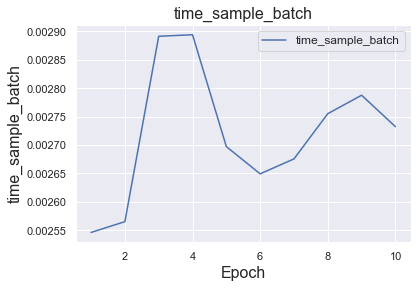

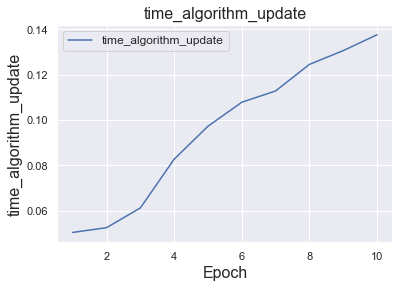

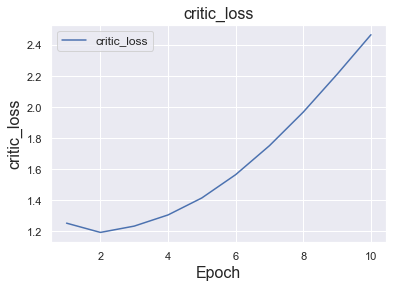

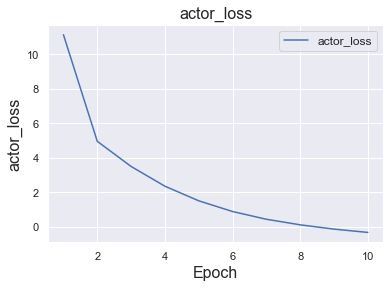

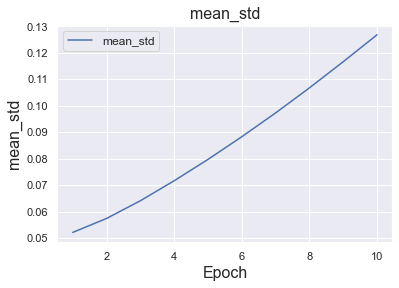

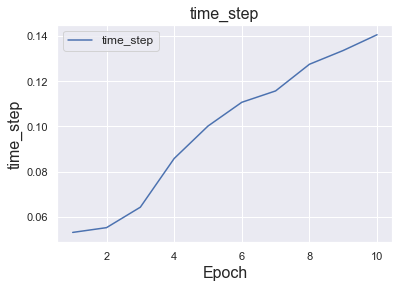

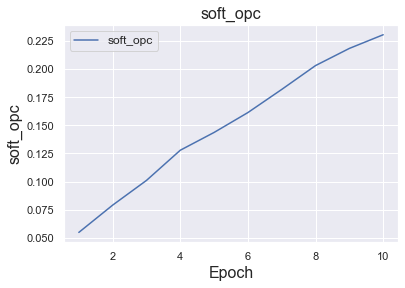

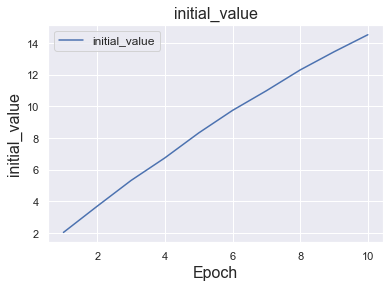

In [17]:
# Métricas que queremos graficar
metrics_to_plot = list(data_train[0][1].keys())

# Crear un gráfico de líneas para cada métr
for metric in metrics_to_plot:
    x = [entry[0] for entry in data_train]
    y = [entry[1][metric] for entry in data_train]
    plt.plot(x, y, label=metric)

    # Etiquetas y título del gráfico
    plt.title(f'{metric}', fontsize=16)

    # Agrandar el tamaño de fuente de la leyenda
    plt.legend(fontsize=12)

    # Etiquetas y título del gráfico
    plt.xlabel('Epoch', fontsize=16)
    plt.ylabel(metric, fontsize=16)

    # Mostrar el gráfico
    plt.show()

### Phase 3: Model evaluation

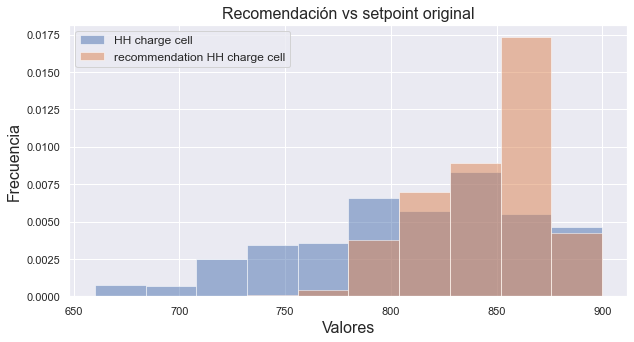

,HH charge cell,recommendation HH charge cell
count,692198.0,692198.0
mean,810.0,846.0
std,52.0,28.0
min,660.0,720.0
25%,770.0,825.0
50%,810.0,853.0
75%,850.0,869.0
max,900.0,895.0


In [18]:
#  rec HH charge cell data train
df_fin=df_mdp_train[states].copy()

original_hh_charge_cell=pd.DataFrame(scaler.inverse_transform(df_fin[states]),columns=states,index=df_fin.index)["HH charge cell"].values

df_fin["HH charge cell"]=awac.predict([observations_train]).squeeze()

df_fin=pd.DataFrame(scaler.inverse_transform(df_fin),columns=df_fin.columns,index=df_fin.index).rename(columns={"HH charge cell":
                                                                                                       "recommendation HH charge cell"})

df_fin["HH charge cell"]=original_hh_charge_cell
ax=df_fin[["HH charge cell","recommendation HH charge cell"]].plot(kind="hist",figsize=(10,5),density=True,alpha=0.5)
ax.set_title("Recomendación vs setpoint original",fontsize=16)
ax.set_xlabel('Valores', fontsize=16)
ax.set_ylabel('Frecuencia', fontsize=16)
ax.legend(fontsize=12)
plt.show()
df_fin[["HH charge cell","recommendation HH charge cell"]].describe().round(0)

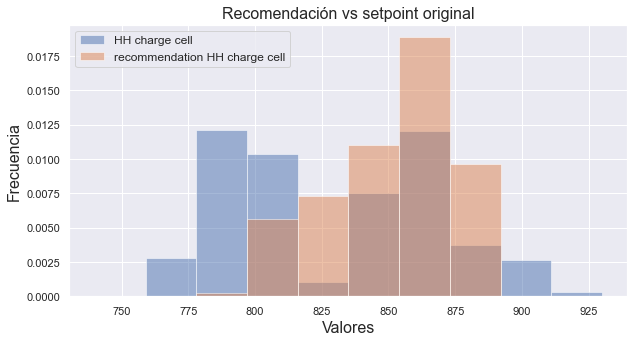

,HH charge cell,recommendation HH charge cell
count,82100.0,82100.0
mean,829.0,851.0
std,41.0,23.0
min,740.0,757.0
25%,790.0,835.0
50%,840.0,856.0
75%,860.0,870.0
max,930.0,893.0


In [19]:
#  rec HH charge cell data test
df_fin=df_mdp_test[states].copy()

original_hh_charge_cell=pd.DataFrame(scaler.inverse_transform(df_fin[states]),columns=states,index=df_fin.index)["HH charge cell"].values

observations_test=df_fin[states].to_numpy()

df_fin["HH charge cell"]=awac.predict([observations_test]).squeeze()

df_fin=pd.DataFrame(scaler.inverse_transform(df_fin),columns=df_fin.columns,index=df_fin.index).rename(columns={"HH charge cell":
                                                                                                       "recommendation HH charge cell"})

df_fin["HH charge cell"]=original_hh_charge_cell
ax=df_fin[["HH charge cell","recommendation HH charge cell"]].plot(kind="hist",figsize=(10,5),density=True,alpha=0.5)
ax.set_title("Recomendación vs setpoint original",fontsize=16)
ax.set_xlabel('Valores', fontsize=16)
ax.set_ylabel('Frecuencia', fontsize=16)
ax.legend(fontsize=12)
plt.show()
df_fin[["HH charge cell","recommendation HH charge cell"]].describe().round(0)

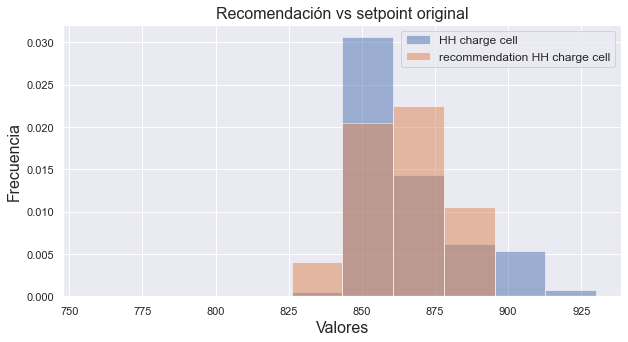

,HH charge cell,recommendation HH charge cell
count,41099.0,41099.0
mean,866.0,863.0
std,18.0,14.0
min,840.0,757.0
25%,850.0,853.0
50%,860.0,864.0
75%,875.0,875.0
max,930.0,893.0


In [20]:
# Test
test=df_mdp_test["2021-09"].copy()
original_hh_charge_cell=pd.DataFrame(scaler.inverse_transform(test[states]),columns=states,index=test.index)["HH charge cell"].values

observations_test=test[states].to_numpy()

test["HH charge cell"]=awac.predict([observations_test]).squeeze()

# Recomendación futura
test["HH charge cell"]=test["HH charge cell"].shift(-desfase)

df_fin=pd.DataFrame(scaler.inverse_transform(test[states]),columns=states,index=test.index).rename(columns={"HH charge cell":
                                                                                                       "recommendation HH charge cell"})
 
                                                                                                       
df_fin["HH charge cell"]=original_hh_charge_cell
df_fin=df_fin.join(df[["power","TPH"]])
df_fin["charge cell/power"]=df_fin["charge cell"]/df_fin["power"]
df_fin.dropna(inplace=True)

ax=df_fin[["HH charge cell","recommendation HH charge cell"]].plot(kind="hist",alpha=0.5,figsize=(10,5),density=True,)
ax.set_title("Recomendación vs setpoint original",fontsize=16)
ax.set_xlabel('Valores', fontsize=16)
ax.set_ylabel('Frecuencia', fontsize=16)
ax.legend(fontsize=12)
plt.show()
df_fin[["HH charge cell","recommendation HH charge cell"]].describe().round(0)

In [27]:
titulos=tuple(["TPH & HH TPH", "Real charge cell setpoint","Recommendation charge cell setpoint","Real charge cell setpoint & Recommendation charge cell setpoint","power",'charge cell/power'])
fig = make_subplots(
    rows=6, cols=1,
    subplot_titles=titulos,
     shared_xaxes=True, 
     vertical_spacing=0.05
    )

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['TPH'], ##FF6511
                    mode='lines',
                    name="TPH",line=dict(width=3, ),legendgroup = '1'),row=1, col=1)  

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['HH TPH'], ##FF6511
                    mode='lines',
                    name="HH TPH",line=dict(width=3, ),legendgroup = '1'),row=1, col=1)  

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['charge cell'], 
                    mode='lines',
                    name="charge cell",line=dict(width=3, ),legendgroup = '1'),row=2, col=1)  



#################
fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['HH charge cell'], 
                    mode='lines',
                    name="HH charge cell",line=dict(width=1, ),legendgroup = '1',showlegend=False),row=2, col=1) 

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['HH charge cell']-80, 
                    mode='lines',
                    name="LL charge cell",line=dict(width=1, ),legendgroup = '1',fill='tonexty',showlegend=False),row=2, col=1)   

#################

######
fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['recommendation HH charge cell'], 
                    mode='lines',
                    name="recommendation HH charge cell",line=dict(width=1, ),legendgroup = '1',showlegend=False),row=3, col=1) 

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['recommendation HH charge cell']-80, 
                    mode='lines',
                    name="recommendation LL charge cell",line=dict(width=1, ),legendgroup = '1',fill='tonexty',showlegend=False),row=3, col=1) 
##############
fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['charge cell'], 
                    mode='lines',
                    name="charge cell",line=dict(width=3, ),legendgroup = '1'),row=3, col=1)  



#############
fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['HH charge cell'], 
                    mode='lines',
                    name="HH charge cell",line=dict(width=3, ),legendgroup = '1',showlegend=False),row=4, col=1) 

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['recommendation HH charge cell'], 
                    mode='lines',
                    name="recommendation HH charge cell",line=dict(width=3, ),legendgroup = '1',showlegend=False),row=4, col=1) 

fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['charge cell'], 
                    mode='lines',
                    name="charge cell",line=dict(width=3, ),legendgroup = '1'),row=4, col=1) 
###############


fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['power'], ##FF6511
                    mode='lines',
                    name='power',line=dict(width=3, ),legendgroup = '1'),row=5, col=1)  


fig.add_trace(go.Scatter(x=df_fin.index, y=df_fin['charge cell/power'], ##FF6511
                    mode='lines',
                    name='charge cell/power',line=dict(width=3, ),legendgroup = '1'),row=6, col=1)  


fig.update_layout(height=700, width=1000, title_text="Temporal signal analysis")
fig.update_layout(hovermode="x unified")

fig.show()